# Analyzing Live Plane Data

# Goal of this Application

In this application, 

### 1️⃣ Ingest Data Fields:
Learn to ingest data from 

### 2️⃣ Store Data into Milvus:
Learn to store data into Milvus, an efficient vector database designed for high-speed similarity searches and AI applications.  

### 3️⃣ Use Open Source Models for Data Queries:
Discover how to use scalars and multiple vectors to query data stored in Milvus and re-rank the final results in this notebook.

### 4️⃣ Display Results:
Build a quick output for validation and checking in this notebook.

### 5️⃣ Simple Retrieval-Augmented Generation (RAG) with LangChain:
Build a simple Python [RAG](https://milvus.io/docs/integrate_with_langchain.md) application (streetcamrag.py) to use Milvus for asking about the current weather via OLLAMA.   While outputing to the screen we also send the results to Slack formatted as Markdown.

# 🔍 Summary
By the end of this application, you’ll have a comprehensive understanding of using Milvus, data ingest object semi-structured and unstructured data, and using Open Source models to build a robust and efficient data retrieval system. 

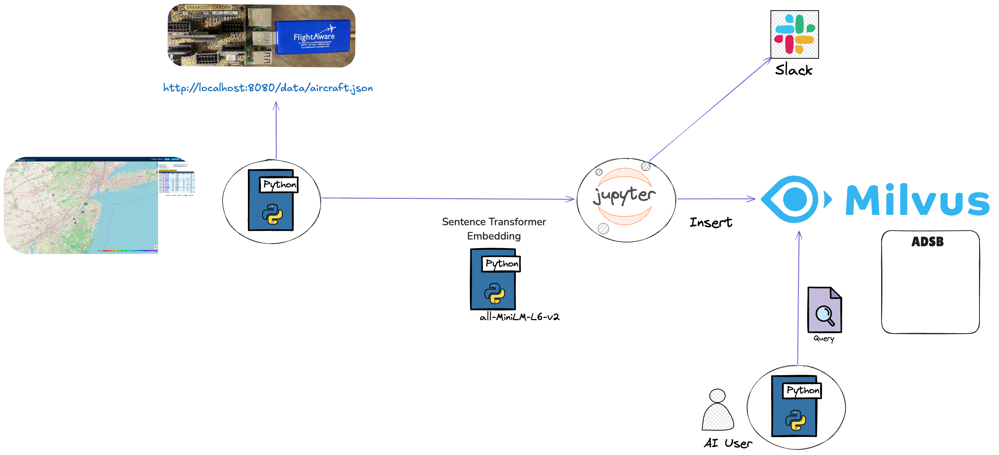



In [1]:
import os
from dotenv import load_dotenv
load_dotenv(override=True)

True

In [24]:
from __future__ import print_function
import requests
import sys
import io
import json
import shutil
import datetime
import subprocess
import sys
import os
import math
import base64
from time import gmtime, strftime
import random, string
import time
import uuid
import socket
from pymilvus import connections
from pymilvus import utility
from pymilvus import FieldSchema, CollectionSchema, DataType, Collection
from pymilvus import MilvusClient


DIMENSION = 384 
# MILVUS_URL = "http://192.168.1.153:19530" 
MILVUS_URL = os.environ.get("SERVERLESS_VECTORDB_URI")
MILVUS_TOKEN = os.environ.get("ZILLIZ_TOKEN")

# milvus_client = MilvusClient("./adsb.db")

DIMENSION = 384 
COLLECTION_NAME = "liveplanes"
PLANE_URL = os.environ.get("PLANE_URL")

milvus_client = MilvusClient( uri=MILVUS_URL, token=MILVUS_TOKEN )


In [25]:
import json
import requests
from pymilvus import model
from pymilvus.model.dense import SentenceTransformerEmbeddingFunction

model = SentenceTransformerEmbeddingFunction('all-MiniLM-L6-v2',device='cpu' )

/Users/timothyspann/Downloads/code/milvusvenv/lib/python3.12/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [29]:
from pymilvus import connections
from pymilvus import utility
from pymilvus import FieldSchema, CollectionSchema, DataType, Collection
import pprint

### Does it exist
if milvus_client.has_collection(collection_name=COLLECTION_NAME):
    print("Exists.")
else:
    ## schema
    
    schema = milvus_client.create_schema(
        enable_dynamic_field=False
    )

    schema.add_field(field_name='id', datatype=DataType.INT64, is_primary=True, auto_id=True)
    schema.add_field(field_name='currentts', datatype=DataType.FLOAT)
    schema.add_field(field_name='currentmessages', datatype=DataType.INT64)
    schema.add_field(field_name='squawk', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='icao', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='flightidentifier', datatype=DataType.VARCHAR, max_length=250)
    schema.add_field(field_name='emergency', datatype=DataType.VARCHAR, max_length=250)
    schema.add_field(field_name='barometricaltitude', datatype=DataType.INT64)
    schema.add_field(field_name='geometricaltitude', datatype=DataType.INT64)
    schema.add_field(field_name='latitude', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='longitude', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='groundspeed', datatype=DataType.FLOAT)
    schema.add_field(field_name='track', datatype=DataType.FLOAT)
    schema.add_field(field_name='baro_rate', datatype=DataType.INT64)
    schema.add_field(field_name='geom_rate', datatype=DataType.INT64)
    schema.add_field(field_name='category', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='nav_qnh', datatype=DataType.INT64)
    schema.add_field(field_name='nav_altitude_mcp', datatype=DataType.INT64)
    schema.add_field(field_name='nav_heading', datatype=DataType.FLOAT)
    schema.add_field(field_name='nic', datatype=DataType.INT64)
    schema.add_field(field_name='rc', datatype=DataType.INT64)
    schema.add_field(field_name='seen_pos', datatype=DataType.FLOAT)
    schema.add_field(field_name='version', datatype=DataType.INT64) 
    schema.add_field(field_name='nic_baro', datatype=DataType.INT64)
    schema.add_field(field_name='nac_p', datatype=DataType.INT64)
    schema.add_field(field_name='nac_v', datatype=DataType.INT64)
    schema.add_field(field_name='sil', datatype=DataType.INT64)
    schema.add_field(field_name='sil_type', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='gva', datatype=DataType.INT64)
    schema.add_field(field_name='sda', datatype=DataType.INT64)
    schema.add_field(field_name='mlat', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='tisb', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='messages', datatype=DataType.INT64)
    schema.add_field(field_name='seen', datatype=DataType.FLOAT)
    schema.add_field(field_name='rssi', datatype=DataType.FLOAT)
    schema.add_field(field_name='currentdatetime', datatype=DataType.VARCHAR, max_length=50)
    schema.add_field(field_name='aircrafttype', datatype=DataType.VARCHAR, max_length=100)
    schema.add_field(field_name='icaotype', datatype=DataType.VARCHAR, max_length=20)
    schema.add_field(field_name='manufacturer', datatype=DataType.VARCHAR, max_length=100)
    schema.add_field(field_name='registration', datatype=DataType.VARCHAR, max_length=100)
    schema.add_field(field_name='registered_owner_country_name', datatype=DataType.VARCHAR, max_length=100)
    schema.add_field(field_name='registered_owner', datatype=DataType.VARCHAR, max_length=100)
    schema.add_field(field_name='url_photo', datatype=DataType.VARCHAR, max_length=100)
    schema.add_field(field_name='flightawaretrackurl', datatype=DataType.VARCHAR, max_length=50)
    schema.add_field(field_name="plane_text_vector", datatype=DataType.FLOAT_VECTOR, dim=DIMENSION)
    schema.add_field(field_name='plane_image_vector', datatype=DataType.FLOAT_VECTOR, dim=512)
    schema.add_field(field_name="details",  datatype=DataType.VARCHAR, max_length=8000)
    schema.add_field(field_name="location",  datatype=DataType.VARCHAR, max_length=2000)    
                     
    index_params = milvus_client.prepare_index_params()
    
    index_params.add_index(
        field_name="id",
        index_type="STL_SORT"
    )

    index_params.add_index(field_name = "plane_image_vector", metric_type="COSINE")

    index_params.add_index(
        field_name="plane_text_vector",
        index_type="IVF_FLAT",
        metric_type="L2",
        params={"nlist": 100}
    )
    
    milvus_client.create_collection(
        collection_name = COLLECTION_NAME,
        schema=schema,
        index_params=index_params
    )
    
    res = milvus_client.get_load_state(
        collection_name = COLLECTION_NAME
    )
    print(res)


{'state': <LoadState: Loaded>}


In [30]:
import glob
import torch
from torchvision import transforms
from PIL import Image
import timm
from sklearn.preprocessing import normalize
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform
import requests
from io import BytesIO


class FeatureExtractor:
    def __init__(self, modelname):
        # Load the pre-trained model
        self.model = timm.create_model(
            modelname, pretrained=True, num_classes=0, global_pool="avg"
        )
        self.model.eval()

        # Get the input size required by the model
        self.input_size = self.model.default_cfg["input_size"]

        config = resolve_data_config({}, model=modelname)
        # Get the preprocessing function provided by TIMM for the model
        self.preprocess = create_transform(**config)

    def __call__(self, imagepath):
        # Preprocess the input image from url
        response = requests.get(imagepath)
        input_image = Image.open(BytesIO(response.content)).convert("RGB")

        # input_image = Image.open(imagepath).convert("RGB")  # Convert to RGB if needed
        input_image = self.preprocess(input_image)

        # Convert the image to a PyTorch tensor and add a batch dimension
        input_tensor = input_image.unsqueeze(0)

        # Perform inference
        with torch.no_grad():
            output = self.model(input_tensor)

        # Extract the feature vector
        feature_vector = output.squeeze().numpy()

        return normalize(feature_vector.reshape(1, -1), norm="l2").flatten()

# Prepare the extractor with model:  resnet34.  
extractor = FeatureExtractor("resnet34")


### ADSB Flight Data

````
field: hex is ICAO identifier
field: flight is IDENT identifier
field: altBaro is the altitude in feet (barometric)
field: lat, lon is latitude and longitude
field: gs is the ground speed in knots
field: altGeom is altitude (geometric)
````

### Enrichment with other data

````

rail, bus, highway, road

https://opensky-network.org/api/flights/departure?airport=KEWR&begin=${now():toNumber():divide(1000):minus(604800)}&end=${now():toNumber():divide(1000)}

https://www.airnowapi.org/aq/observation

https://api.openaq.org/v2/measurements?country=US

https://forecast.weather.gov/MapClick.php?lat={0}&lon={1}&unit=0&lg=english&FcstType=json

````

### Resources

* https://github.com/tspannhw/FLaNK-ADSB
* https://github.com/tspannhw/FLaNK-AircraftTracking
* https://github.com/tspannhw/FLiP-Py-ADS-B
* https://github.com/tspannhw/pulsar-adsb-function
* https://openskynetwork.github.io/opensky-api/rest.html

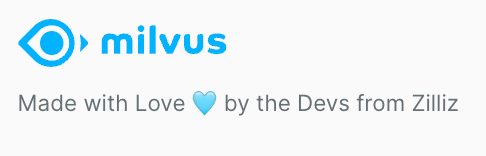

In [32]:
import string
import random
import numpy
from datetime import datetime

def id_generator(size=10, chars=string.ascii_uppercase + string.digits):
    return ''.join(random.choice(chars) for _ in range(size))

response = requests.get(str(PLANE_URL + str(id_generator()))).content
planes = json.loads(response)
currentts = planes['now']
currentmessages = planes['messages']

data = []
details = ""
location = ""

for jsonitems in planes['aircraft']:
         icao = jsonitems.get('hex','NA')
         flightidentifier = jsonitems.get('flight','NA')
         flightidentifier = flightidentifier.strip()
         barometricaltitude = jsonitems.get('alt_baro',0)
         geometricaltitude = jsonitems.get('alt_geom',0)
         latitude = str(jsonitems.get('lat','0'))
         squawk = jsonitems.get('squawk',0)
         emergency = jsonitems.get('emergency','none')
         longitude = str(jsonitems.get('lon','0'))
         groundspeed = jsonitems.get('gs',0)
         track = jsonitems.get('track',0.00)
         baro_rate = jsonitems.get('baro_rate',0)
         geom_rate = jsonitems.get('geom_rate',0)
         category = jsonitems.get('category','NA')
         nav_qnh = jsonitems.get('nav_qnh',0)
         nav_altitude_mcp = jsonitems.get('nav_altitude_mcp',0)
         nav_heading  = jsonitems.get('nav_heading',0.0)
         nic = jsonitems.get('nic',0) 
         rc = jsonitems.get('rc',0)
         seen_pos  = jsonitems.get('seen_pos',0.0) 
         version = jsonitems.get('version',0) 
         nic_baro = jsonitems.get('nic_baro',0) 
         nac_p = jsonitems.get('nac_p',0)
         nac_v = jsonitems.get('nac_v',0)
         sil = jsonitems.get('sil',0)
         sil_type = jsonitems.get('sil_type','NA')
         gva = jsonitems.get('gva',0)
         sda = jsonitems.get('sda',0)
         mlat = jsonitems.get('mlat','NA')
         tisb = jsonitems.get('tisb','NA')
         messages = jsonitems.get('messages',0)
         seen  = jsonitems.get('seen',0.0) 
         rssi  = jsonitems.get('rssi',0.0) 
         currentdatetime = str( datetime.today().strftime('%Y-%m-%d %H:%M:%S') )
    
         planetypedetails = requests.get("https://api.adsbdb.com/v0/aircraft/" + str(icao)).content
         planesjsonb = json.loads(planetypedetails)
         aircrafttype = 'NA'
         icaotype = 'NA'
         manufacturer = 'NA'
         registration = 'NA'
         registered_owner_country_name = 'NA'
         registered_owner = 'NA'
         url_photo = ''
         flightawaretrackurl = ''

         try:
             if ( planesjsonb['response'] ):
                 if ( planesjsonb['response']['aircraft'] ):
                     if ( planesjsonb['response']['aircraft']['type'] ):
                         aircrafttype = planesjsonb['response']['aircraft']['type']
                     if ( planesjsonb['response']['aircraft']['icao_type'] ):
                         icaotype = planesjsonb['response']['aircraft']['icao_type']
                     if ( planesjsonb['response']['aircraft']['manufacturer'] ):
                         manufacturer = planesjsonb['response']['aircraft']['manufacturer']
                     if ( planesjsonb['response']['aircraft']['mode_s'] ):
                         mode_s = planesjsonb['response']['aircraft']['mode_s']   
                     if ( planesjsonb['response']['aircraft']['registration'] ):
                         registration = planesjsonb['response']['aircraft']['registration']   
                     if ( planesjsonb['response']['aircraft']['registered_owner_country_name'] ):
                         registered_owner_country_name = planesjsonb['response']['aircraft']['registered_owner_country_name']   
                     if ( planesjsonb['response']['aircraft']['registered_owner'] ):
                         registered_owner = planesjsonb['response']['aircraft']['registered_owner']   
                     if ( planesjsonb['response']['aircraft']['url_photo'] ):
                         url_photo = planesjsonb['response']['aircraft']['url_photo']   
         except Exception as e:
           print("response is null", e)
            
         if (len(url_photo) <= 20 ):
             url_photo = "https://raw.githubusercontent.com/tspannhw/AIM-ADS-B/refs/heads/main/milvusplane5.jpg"
            
         flightawaretrackurl = 'https://www.flightaware.com/live/flight/' + str(flightidentifier) 
    
         location = 'Location @ {0},{1} with altitude of {2} feet (baro) / {3} feet (geo).'.format(latitude, longitude, barometricaltitude,geometricaltitude )
         details = 'The aircraft in flight is {0} of {1} which is aircraft type {2} built by {3} from {4} - {5} it is traveling at a speed of {6} mph @ {7}. {8}. {9}'.format( flightidentifier, icaotype, icaotype,
                                                                                                              manufacturer, registered_owner, registered_owner_country_name, groundspeed,
                                                                                                              currentdatetime, location, url_photo )
         # print(details)
             
         data.append({"currentts": currentts, "currentmessages": currentmessages, "squawk": str(squawk), "icao": str(icao), 
                      "flightidentifier": str(flightidentifier), "emergency": str(emergency), "barometricaltitude": int(barometricaltitude), "geometricaltitude": int(geometricaltitude),
                      "latitude": str(latitude), "longitude": str(longitude), "groundspeed": float(groundspeed),"track": float(track), "baro_rate": int(baro_rate),"geom_rate": int(geom_rate), 
                      "category": str(category), "nav_qnh": int(nav_qnh), "nav_altitude_mcp": int(nav_altitude_mcp),"nav_heading": float(nav_heading), "nic": int(nic), "rc": int(rc), 
                      "seen_pos": float(seen_pos),  "version": int(version), "nic_baro": int(nic_baro), "nac_p": int(nac_p), "nac_v": int(nac_v),
                      "sil": int(sil),"sil_type": str(sil_type), "gva": int(gva), "sda": int(sda), "mlat": str(mlat), "tisb": str(tisb), "messages": int(messages), "seen": float(seen), 
                      "rssi": float(rssi), "currentdatetime": str(currentdatetime), "aircrafttype": str(aircrafttype), "icaotype": str(icaotype), "manufacturer": str(manufacturer),
                      "registration": str(registration), "registered_owner_country_name": str(registered_owner_country_name), "registered_owner": str(registered_owner), 
                      "url_photo": str(url_photo), "flightawaretrackurl": str(flightawaretrackurl), "plane_text_vector": model(details), 
                      "plane_image_vector":  extractor(url_photo), "details": details, "location": location})

res = milvus_client.insert(collection_name=COLLECTION_NAME, data=data)
# print(res)
# print(data)

response is null string indices must be integers, not 'str'


## Example JSON

```

{'response': {'flightroute': {'callsign': 'JIA5295', 'callsign_icao': 'JIA5295', 'callsign_iata': 'US5295', 'airline': {'name': 'PSA Airlines', 'icao': 'JIA', 'iata': 'US', 'country': 'United States', 'country_iso': 'US', 'callsign': 'BLUE STREAK'}, 'origin': {'country_iso_name': 'US', 'country_name': 'United States', 'elevation': 46, 'iata_code': 'CHS', 'icao_code': 'KCHS', 'latitude': 32.898602, 'longitude': -80.040497, 'municipality': 'Charleston', 'name': 'Charleston International Airport'}, 'destination': {'country_iso_name': 'US', 'country_name': 'United States', 'elevation': 36, 'iata_code': 'PHL', 'icao_code': 'KPHL', 'latitude': 39.87189865112305, 'longitude': -75.24109649658203, 'municipality': 'Philadelphia', 'name': 'Philadelphia International Airport'}}}}

```

In [ ]:
## query



In [36]:
#          # image https://asn.flightsafety.org/graphics/ICAOtype/B39M.gif   icaotype

query_image = "https://github.com/tspannhw/AIM-ADS-B/blob/main/milvusplane5.jpg?raw=true"

results = milvus_client.search(
    COLLECTION_NAME,
    anns_field="plane_image_vector",
    data=[extractor(query_image)],
    output_fields=["details", "groundspeed","flightidentifier","icao", "url_photo", "id"],
    search_params={"metric_type": "COSINE"})
    

The aircraft in flight is CKS615 of B744 which is aircraft type B744 built by Boeing from Kalitta Air - United States it is traveling at a speed of 441.3 mph @ 2024-09-22 15:44:40. Location @ 40.181331,-74.76396 with altitude of 22525 feet (baro) / 23250 feet (geo).. https://raw.githubusercontent.com/tspannhw/AIM-ADS-B/refs/heads/main/milvusplane5.jpg


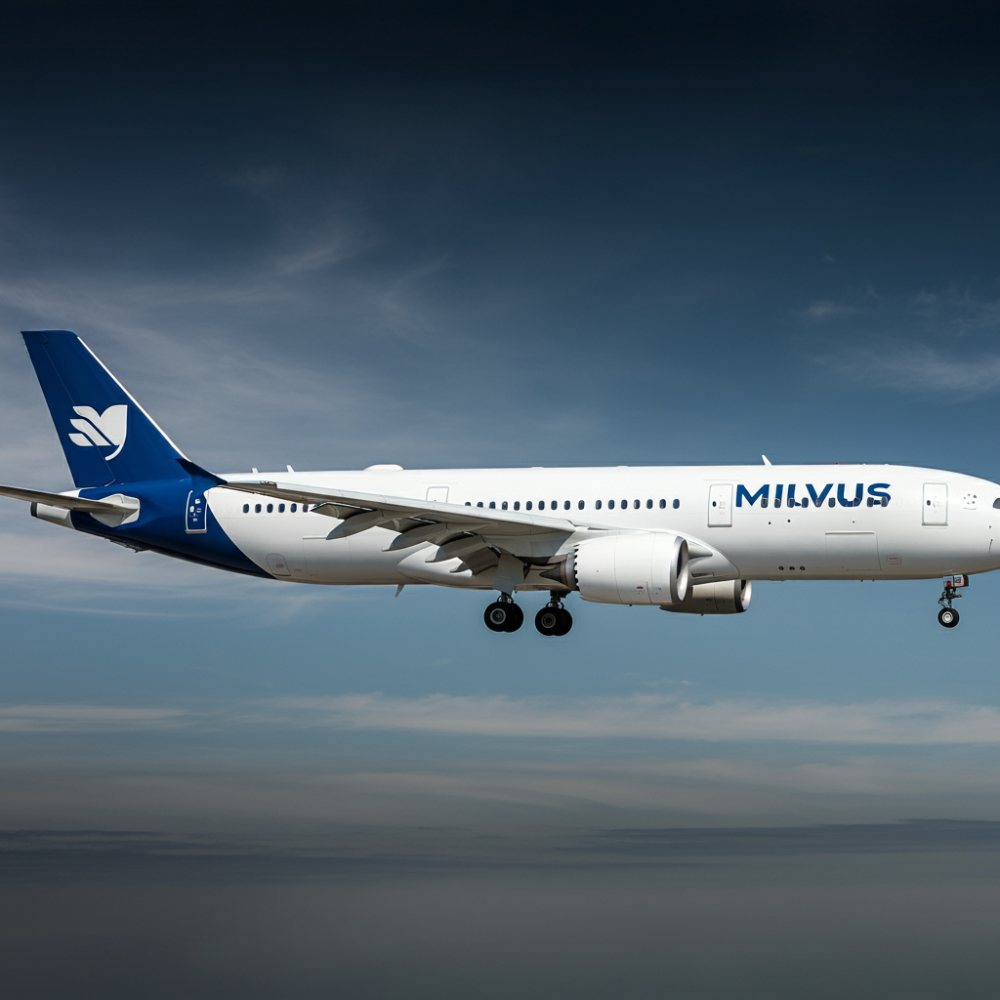

The aircraft in flight is NA of E45X which is aircraft type E45X built by Embraer from United Express - United States it is traveling at a speed of 0 mph @ 2024-09-22 15:44:40. Location @ 0,0 with altitude of 0 feet (baro) / 0 feet (geo).. https://raw.githubusercontent.com/tspannhw/AIM-ADS-B/refs/heads/main/milvusplane5.jpg


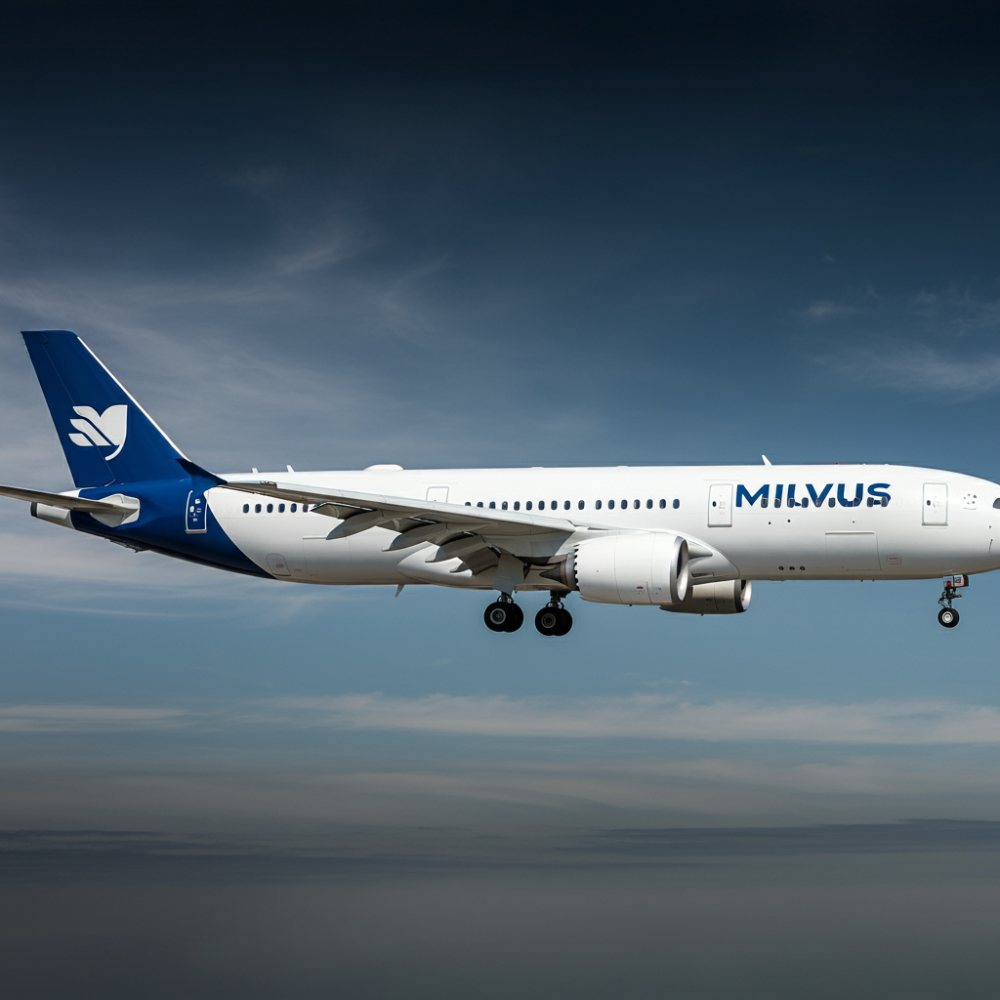

The aircraft in flight is NA of B38M which is aircraft type B38M built by Boeing from Boeing - United States it is traveling at a speed of 0 mph @ 2024-09-22 15:44:39. Location @ 0,0 with altitude of 0 feet (baro) / 0 feet (geo).. https://raw.githubusercontent.com/tspannhw/AIM-ADS-B/refs/heads/main/milvusplane5.jpg


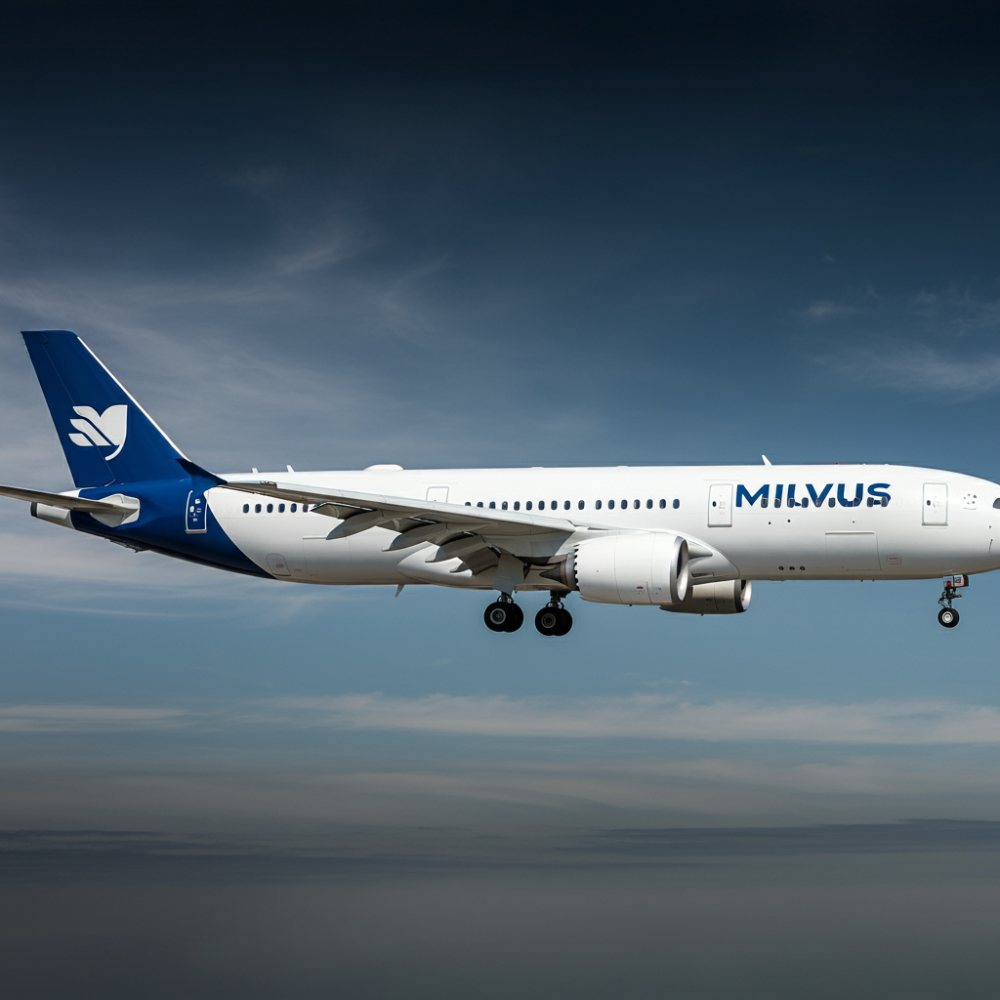

In [40]:
from IPython.display import display

for result in results:
    # print(result)
    for hit in result[:3]:
        photo = hit["entity"]["url_photo"]
        response = requests.get(photo)
        img = Image.open(BytesIO(response.content)).convert("RGB")

        print(hit["entity"]["details"])
        display(img)

In [51]:
from pymilvus import (
    connections,
    db,
    FieldSchema,
    CollectionSchema,
    DataType,
    Collection,
    utility
)
from typing import List, Tuple

connections.connect(
    uri=MILVUS_URL,
    token=MILVUS_TOKEN)

fields = [
     FieldSchema(name='id', dtype=DataType.INT64, is_primary=True, auto_id=True),
     FieldSchema(name='currentts', dtype=DataType.FLOAT),
     FieldSchema(name='currentmessages', dtype=DataType.INT64),
     FieldSchema(name='squawk', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='icao', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='flightidentifier', dtype=DataType.VARCHAR, max_length=250),
     FieldSchema(name='emergency', dtype=DataType.VARCHAR, max_length=250),
     FieldSchema(name='barometricaltitude', dtype=DataType.INT64),
     FieldSchema(name='geometricaltitude', dtype=DataType.INT64),
     FieldSchema(name='latitude', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='longitude', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='groundspeed', dtype=DataType.FLOAT),
     FieldSchema(name='track', dtype=DataType.FLOAT),
     FieldSchema(name='baro_rate', dtype=DataType.INT64),
     FieldSchema(name='geom_rate', dtype=DataType.INT64),
     FieldSchema(name='category', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='nav_qnh', dtype=DataType.INT64),
     FieldSchema(name='nav_altitude_mcp', dtype=DataType.INT64),
     FieldSchema(name='nav_heading', dtype=DataType.FLOAT),
     FieldSchema(name='nic', dtype=DataType.INT64),
     FieldSchema(name='rc', dtype=DataType.INT64),
     FieldSchema(name='seen_pos', dtype=DataType.FLOAT),
     FieldSchema(name='version', dtype=DataType.INT64) ,
     FieldSchema(name='nic_baro', dtype=DataType.INT64),
     FieldSchema(name='nac_p', dtype=DataType.INT64),
     FieldSchema(name='nac_v', dtype=DataType.INT64),
     FieldSchema(name='sil', dtype=DataType.INT64),
     FieldSchema(name='sil_type', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='gva', dtype=DataType.INT64),
     FieldSchema(name='sda', dtype=DataType.INT64),
     FieldSchema(name='mlat', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='tisb', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='messages', dtype=DataType.INT64),
     FieldSchema(name='seen', dtype=DataType.FLOAT),
     FieldSchema(name='rssi', dtype=DataType.FLOAT),
     FieldSchema(name='currentdatetime', dtype=DataType.VARCHAR, max_length=50),
     FieldSchema(name='aircrafttype', dtype=DataType.VARCHAR, max_length=100),
     FieldSchema(name='icaotype', dtype=DataType.VARCHAR, max_length=20),
     FieldSchema(name='manufacturer', dtype=DataType.VARCHAR, max_length=100),
     FieldSchema(name='registration', dtype=DataType.VARCHAR, max_length=100),
     FieldSchema(name='registered_owner_country_name', dtype=DataType.VARCHAR, max_length=100),
     FieldSchema(name='registered_owner', dtype=DataType.VARCHAR, max_length=100),
     FieldSchema(name='url_photo', dtype=DataType.VARCHAR, max_length=100),
     FieldSchema(name='flightawaretrackurl', dtype=DataType.VARCHAR, max_length=50),
     FieldSchema(name='plane_text_vector', dtype=DataType.FLOAT_VECTOR, dim=DIMENSION),
     FieldSchema(name='plane_image_vector', dtype=DataType.FLOAT_VECTOR, dim=512),
     FieldSchema(name='details',  dtype=DataType.VARCHAR, max_length=8000),
     FieldSchema(name='location',  dtype=DataType.VARCHAR, max_length=2000)    
]
schema = CollectionSchema(fields=fields,enable_dynamic_field=False)

# Create collection
collection = Collection(name=COLLECTION_NAME, schema=schema)
    
# Create index for each vector field
index_params = {
    "metric_type": "L2",
    "index_type": "IVF_FLAT",
    "params": {"nlist": 128},
}

index_params2 = {
    "metric_type": "COSINE"
}

index_params3 = {
    "index_type": "STL_SORT"
}

In [61]:
from pymilvus import AnnSearchRequest, RRFRanker, WeightedRanker
import time
querymodel = SentenceTransformerEmbeddingFunction('all-MiniLM-L6-v2',device='cpu' )

query_TextVector = "The aircraft in flight is "
query_ImageVector = "https://airport-data.com/images/aircraft/001/606/001606420.jpg"

search_param_0 = {
    "data": [extractor(query_ImageVector)], # Query vector
    "anns_field": "plane_image_vector", # Vector field name
    "param": {
        "metric_type": "COSINE", # This parameter value must be identical to the one used in the collection schema
    },
    "expr": "flightidentifier != 'NA'",
    "limit": 10 # Number of search results to return in this AnnSearchRequest
}


request_0 = AnnSearchRequest(**search_param_0)

search_param_1 = {
    "data": [querymodel(str(query_TextVector))], # Query vector
    "anns_field": "plane_text_vector", # Vector field name
    "param": {
        "metric_type": "L2", # This parameter value must be identical to the one used in the collection schema
        "params": {"nprobe": 10}
    },
    "expr": "flightidentifier != 'NA'",
    "limit": 10 # Number of search results to return in this AnnSearchRequest
}
    
request_1 = AnnSearchRequest(**search_param_1)

reqs = [request_0, request_1]
# Rerank by RRF strategy
rerank = RRFRanker(k=60)

collection.load()

# Run a start and end time for our search
# Search collection vector from above
t0 = time.time()

results = collection.hybrid_search(
    reqs, # List of AnnSearchRequests created in step 1
    rerank, # Reranking strategy specified in step 2
    output_fields=["details", "groundspeed","flightidentifier","icao", "url_photo", "id"],
    limit=15 # Number of final search results to return
)

t1 = time.time()
print(f"search latency: {round(t1-t0, 4)} seconds\n\n")
# print(res)

/Users/timothyspann/Downloads/code/milvusvenv/lib/python3.12/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


search latency: 0.1053 seconds




Distance: >> 0.03177805617451668 <<  ID:452498223105293658


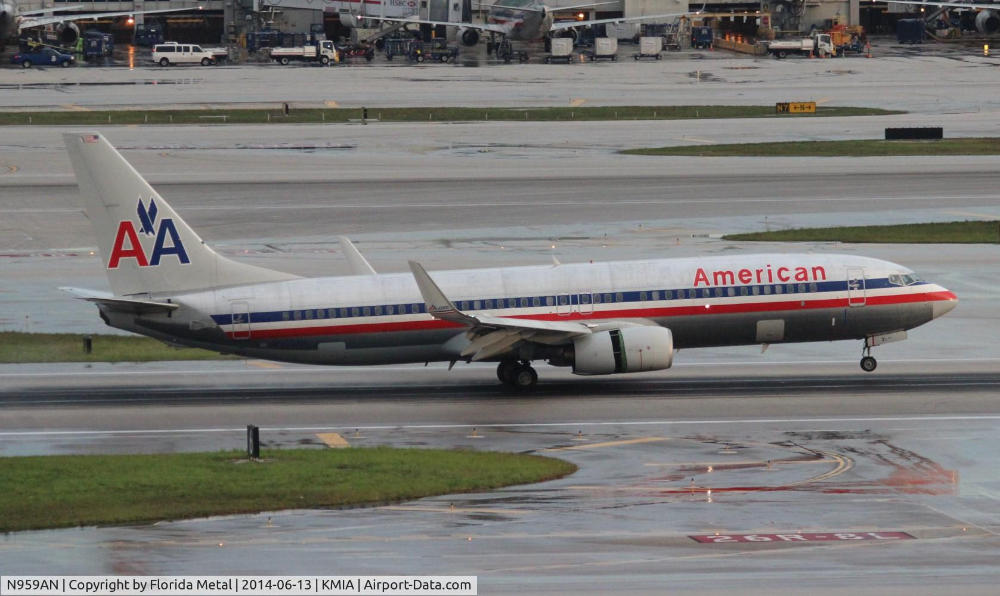

Details: AAL1064 : The aircraft in flight is AAL1064 of B738 which is aircraft type B738 built by Boeing from American Airlines - United States it is traveling at a speed of 274.6 mph @ 2024-09-22 15:44:31. Location @ 40.16304,-74.557068 with altitude of 9925 feet (baro) / 10175 feet (geo).. https://airport-data.com/images/aircraft/001/606/001606420.jpg


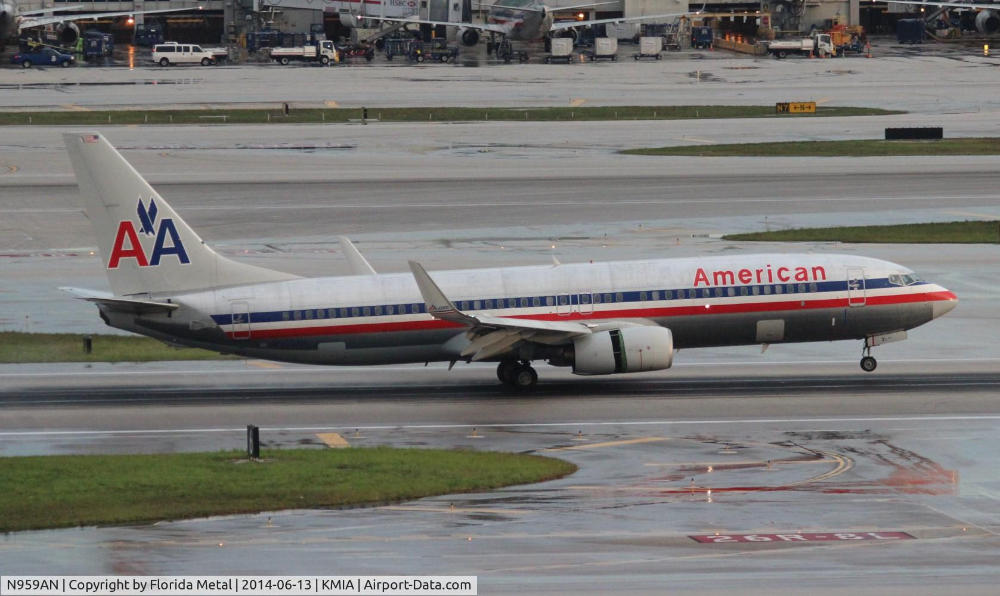

Distance: >> 0.03177805617451668 <<  ID:452498223105293669


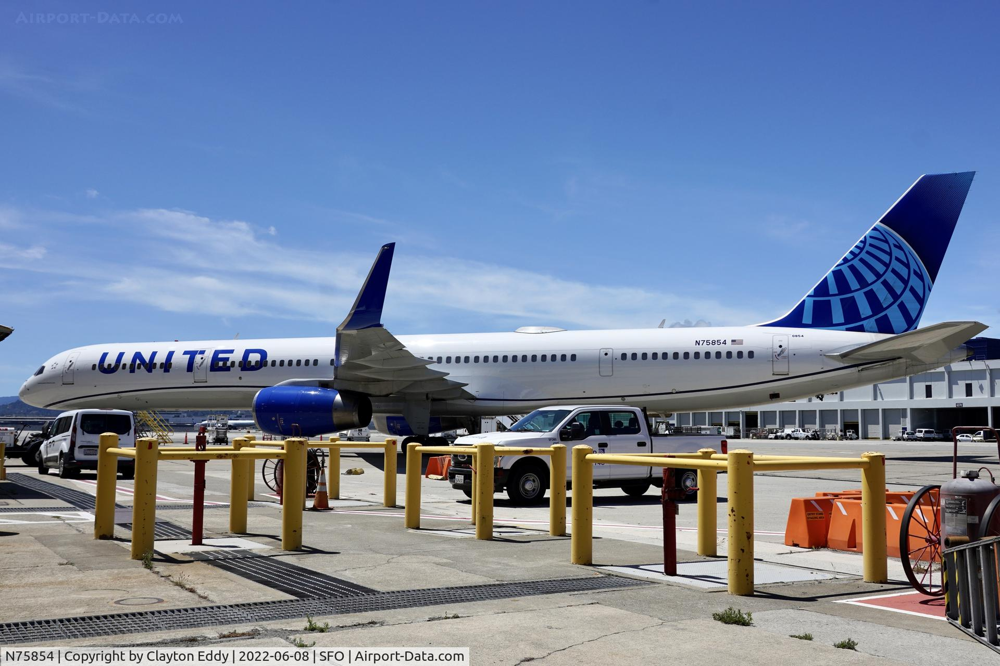

Details: UAL2072 : The aircraft in flight is UAL2072 of B753 which is aircraft type B753 built by Boeing from United Airlines - United States it is traveling at a speed of 171.8 mph @ 2024-09-22 15:44:38. Location @ 40.317357,-74.417641 with altitude of 2925 feet (baro) / 2950 feet (geo).. https://airport-data.com/images/aircraft/001/695/001695759.jpg


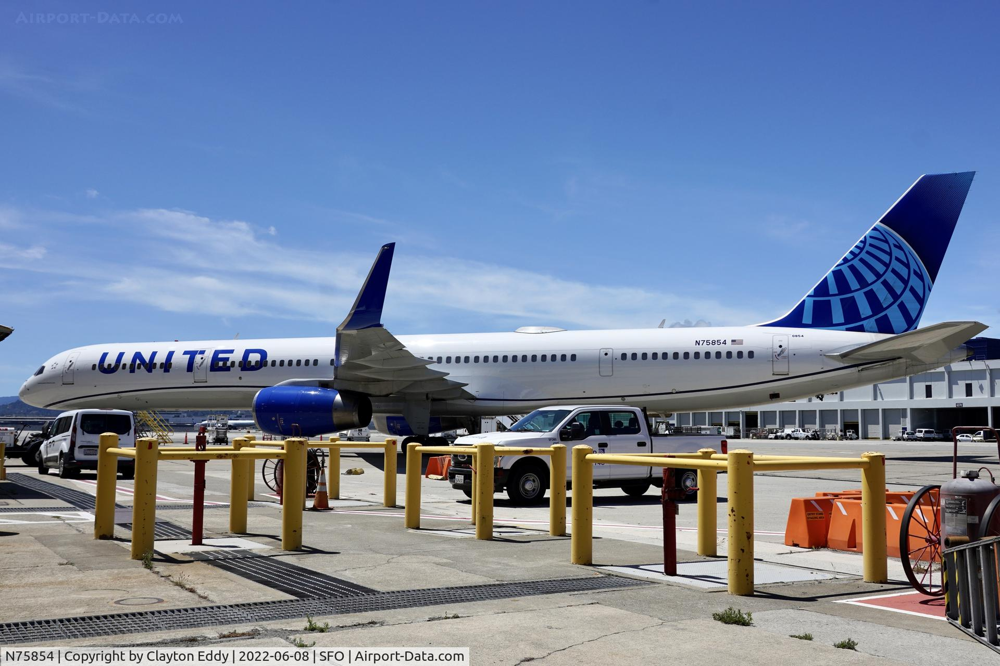

Distance: >> 0.0317460335791111 <<  ID:452498223105293675


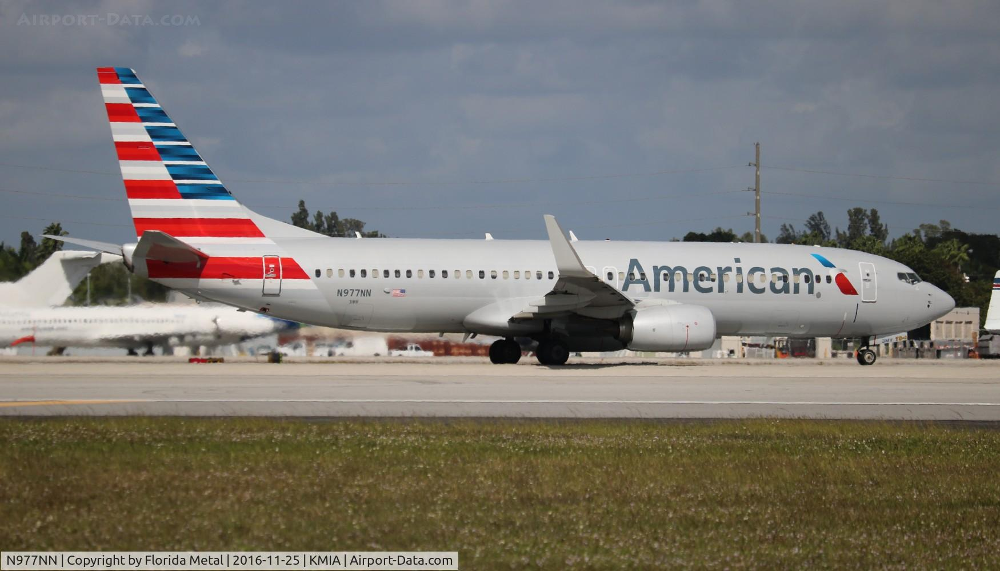

Details: AAL541 : The aircraft in flight is AAL541 of B738 which is aircraft type B738 built by Boeing from American Airlines - United States it is traveling at a speed of 264.1 mph @ 2024-09-22 15:44:42. Location @ 40.354019,-74.311584 with altitude of 6925 feet (baro) / 7050 feet (geo).. https://airport-data.com/images/aircraft/001/530/001530966.jpg


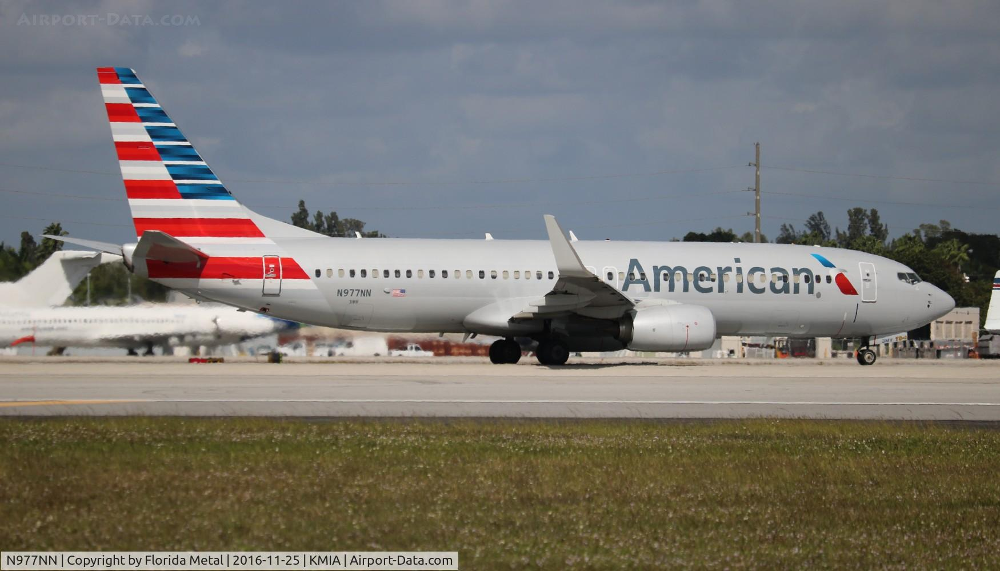

In [62]:
# -----------------------------------------------------------------------------
# Iterate through last <limit> results and display scalars
# -----------------------------------------------------------------------------
for result in results:
    for row in result[:3]:
        print( "Distance: >> " + str(row.distance) + " <<  ID:" + str(row.id) )
        photo = row.entity.url_photo
        response = requests.get(photo)
        img = Image.open(BytesIO(response.content)).convert("RGB")
        display(img)
        print("Details: " + str(row.entity.flightidentifier) + " : " + 
             str(row.entity.details))
        display(img)

In [43]:
milvus_client.load_collection(COLLECTION_NAME)

res = milvus_client.get_load_state(
        collection_name = COLLECTION_NAME
)

# print(res)

query_results = milvus_client.query(
    collection_name=COLLECTION_NAME,
    filter='flightidentifier != "NA" && url_photo != "https://raw.githubusercontent.com/tspannhw/AIM-ADS-B/refs/heads/main/milvusplane5.jpg"  && registered_owner like "United%" && registered_owner_country_name == "United States"',
    output_fields=["registered_owner","details", "groundspeed","flightidentifier","icao", "url_photo", "id"],
    limit=3
)

lastvector = None

for result in query_results:
    print(f"{result['registered_owner']} : {result['flightidentifier']} {result['details']} \n")

United Airlines : UAL2072 The aircraft in flight is UAL2072 of B753 which is aircraft type B753 built by Boeing from United Airlines - United States it is traveling at a speed of 171.8 mph @ 2024-09-22 15:44:38. Location @ 40.317357,-74.417641 with altitude of 2925 feet (baro) / 2950 feet (geo).. https://airport-data.com/images/aircraft/001/695/001695759.jpg 

United Airlines : UAL509 The aircraft in flight is UAL509 of B764 which is aircraft type B764 built by Boeing from United Airlines - United States it is traveling at a speed of 184.9 mph @ 2024-09-22 15:44:45. Location @ 40.345642,-74.41394 with altitude of 2950 feet (baro) / 3000 feet (geo).. https://airport-data.com/images/aircraft/001/709/001709829.jpg 



In [46]:
import time

current_time = int( time.time() )
begint = int ( (current_time ) - 604800 )
endt = int(current_time)

OPENSKY_URL = "https://opensky-network.org/api/flights/departure?airport=KEWR&begin="
OPENSKY_FULL_URL = str( OPENSKY_URL + str(begint) + "&end=" + str(endt) )

response = requests.get(OPENSKY_FULL_URL).content
airportdata = json.loads(response)

for flight in airportdata:
    print(aflight)
    break
    #    print(flight['icao24'])

# firstSeen': 1726946190
# estDepartureAirport': 'MMMX' 
# lastSeen': 1726962555
# estArrivalAirport': 'KEWR'
# callsign': 'UAL2252 '
# estDepartureAirportHorizDistance': 3831
# estDepartureAirportVertDistance': 155
# estArrivalAirportHorizDistance': 1326
# estArrivalAirportVertDistance': 5
# departureAirportCandidatesCount': 0
# arrivalAirportCandidatesCount': 5

# --- Future Thought
#response2 = requests.get("https://opensky-network.org/api/states/all?time=" + str(current_time) + "&icao24=a6f9fa").content
#print(response2)                        

### Flight Arrivals for newark airport
OPENSKY_URL = "https://opensky-network.org/api/flights/arrival?airport=KEWR&begin="
OPENSKY_FULL_URL = str(  OPENSKY_URL + str(begint) + "&end=" + str(endt) )
aresponse = requests.get(OPENSKY_FULL_URL).content
aairportdata = json.loads(aresponse)
#print(airportdata)

for aflight in aairportdata:
    # print(aflight['icao24'])
    print(aflight)
    break
#'firstSeen': 1726946190, 
#'estDepartureAirport': 'MMMX', 
#'lastSeen': 1726962555, 
#'estArrivalAirport': 'KEWR', 
#'callsign': 'UAL2252 ', 
#'estDepartureAirportHorizDistance': 3831, 
#'estDepartureAirportVertDistance': 155, 
#'estArrivalAirportHorizDistance': 1326, 
#'estArrivalAirportVertDistance': 5, 
#'departureAirportCandidatesCount': 0, 
#'arrivalAirportCandidatesCount'

### Future thought:   iterate many airports
airports = {"KATL",
"KEWR",
"KJFK",
"KLGA",
"KDFW",
"KDEN",
"KORD",
"KLAX",
"KLAS",
"KMCO",
"KMIA",
"KCLT",
"KSEA",
"KPHX",
"KSFO",
"KIAH",
"KBOS",
"KFLL",
"KMSP",
"KPHL",
"KDCA",
"KSAN",
"KBWI",
"KTPA",
"KAUS",
"KIAD",
"KMDW"}

#for x in airports:
#    print(x)
    

{'icao24': 'a0bf8c', 'firstSeen': 1726946190, 'estDepartureAirport': 'MMMX', 'lastSeen': 1726962555, 'estArrivalAirport': 'KEWR', 'callsign': 'UAL2252 ', 'estDepartureAirportHorizDistance': 3831, 'estDepartureAirportVertDistance': 155, 'estArrivalAirportHorizDistance': 1326, 'estArrivalAirportVertDistance': 5, 'departureAirportCandidatesCount': 0, 'arrivalAirportCandidatesCount': 5}
{'icao24': 'a0bf8c', 'firstSeen': 1726946190, 'estDepartureAirport': 'MMMX', 'lastSeen': 1726962555, 'estArrivalAirport': 'KEWR', 'callsign': 'UAL2252 ', 'estDepartureAirportHorizDistance': 3831, 'estDepartureAirportVertDistance': 155, 'estArrivalAirportHorizDistance': 1326, 'estArrivalAirportVertDistance': 5, 'departureAirportCandidatesCount': 0, 'arrivalAirportCandidatesCount': 5}


In [47]:
from transformers import AutoModelForCausalLM, AutoTokenizer
checkpoint = "jinaai/reader-lm-1.5b"

device = "cpu" # for GPU usage or "cpu" for CPU usage
tokenizer = AutoTokenizer.from_pretrained(checkpoint)
model = AutoModelForCausalLM.from_pretrained(checkpoint).to(device)

# example html content
html_content = "<html><body><h1>Hello, world!</h1></body></html>"

messages = [{"role": "user", "content": html_content}]
input_text=tokenizer.apply_chat_template(messages, tokenize=False)

# print(input_text)

inputs = tokenizer.encode(input_text, return_tensors="pt").to(device)
outputs = model.generate(inputs, max_new_tokens=1024, temperature=0, do_sample=False, repetition_penalty=1.08)

print('-----')
print(tokenizer.decode(outputs[0]))

### convert airplane HTML to markdown


/Users/timothyspann/Downloads/code/milvusvenv/lib/python3.12/site-packages/transformers/generation/configuration_utils.py:567: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
/Users/timothyspann/Downloads/code/milvusvenv/lib/python3.12/site-packages/transformers/generation/configuration_utils.py:572: UserWarning: `do_sample` is set to `False`. However, `top_p` is set to `0.8` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `top_p`.
  warnings.warn(
/Users/timothyspann/Downloads/code/milvusvenv/lib/python3.12/site-packages/transformers/generation/configuration_utils.py:589: UserWarning: `do_sample` is set to `False`. However, `top_k` is set to `20` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `top_k`.
  warnings.warn

-----
<|im_start|>system
You are a helpful assistant.<|im_end|>
<|im_start|>user
<html><body><h1>Hello, world!</h1></body></html><|im_end|>
<|im_start|>assistant
Hello, world!<|im_end|>
